In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
import warnings

warnings.filterwarnings('ignore') # To not display warnings

In [3]:
dataset_list = [
    pd.read_csv('03-02-2018.csv'),
    pd.read_csv('03-01-2018.csv'),
    pd.read_csv('02-23-2018.csv'),
    pd.read_csv('02-14-2018.csv') 
]

In [4]:
dataset = pd.concat(dataset_list, ignore_index=True, axis=0)
del dataset_list # To save memory

In [5]:
dataset.head(n=5)

,Dst Port,Protocol,Timestamp,Flow Duration,Tot Fwd Pkts,Tot Bwd Pkts,TotLen Fwd Pkts,TotLen Bwd Pkts,Fwd Pkt Len Max,Fwd Pkt Len Min,...,Fwd Seg Size Min,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Label
0,443,6,02/03/2018 08:47:38,141385,9,7,553,3773.0,202,0,...,20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Benign
1,49684,6,02/03/2018 08:47:38,281,2,1,38,0.0,38,0,...,20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Benign
2,443,6,02/03/2018 08:47:40,279824,11,15,1086,10527.0,385,0,...,20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Benign
3,443,6,02/03/2018 08:47:40,132,2,0,0,0.0,0,0,...,20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Benign
4,443,6,02/03/2018 08:47:41,274016,9,13,1285,6141.0,517,0,...,20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Benign


In [6]:
print(f"The dataset is made up of {len(dataset)} instances")

The dataset is made up of 3476825 instances


In [7]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3476825 entries, 0 to 3476824
Data columns (total 80 columns):
 #   Column             Dtype  
---  ------             -----  
 0   Dst Port           int64  
 1   Protocol           int64  
 2   Timestamp          object 
 3   Flow Duration      int64  
 4   Tot Fwd Pkts       int64  
 5   Tot Bwd Pkts       int64  
 6   TotLen Fwd Pkts    int64  
 7   TotLen Bwd Pkts    float64
 8   Fwd Pkt Len Max    int64  
 9   Fwd Pkt Len Min    int64  
 10  Fwd Pkt Len Mean   float64
 11  Fwd Pkt Len Std    float64
 12  Bwd Pkt Len Max    int64  
 13  Bwd Pkt Len Min    int64  
 14  Bwd Pkt Len Mean   float64
 15  Bwd Pkt Len Std    float64
 16  Flow Byts/s        float64
 17  Flow Pkts/s        float64
 18  Flow IAT Mean      float64
 19  Flow IAT Std       float64
 20  Flow IAT Max       float64
 21  Flow IAT Min       float64
 22  Fwd IAT Tot        float64
 23  Fwd IAT Mean       float64
 24  Fwd IAT Std        float64
 25  Fwd IAT Max       

In [8]:
dataset.columns

Index(['Dst Port', 'Protocol', 'Timestamp', 'Flow Duration', 'Tot Fwd Pkts',
       'Tot Bwd Pkts', 'TotLen Fwd Pkts', 'TotLen Bwd Pkts', 'Fwd Pkt Len Max',
       'Fwd Pkt Len Min', 'Fwd Pkt Len Mean', 'Fwd Pkt Len Std',
       'Bwd Pkt Len Max', 'Bwd Pkt Len Min', 'Bwd Pkt Len Mean',
       'Bwd Pkt Len Std', 'Flow Byts/s', 'Flow Pkts/s', 'Flow IAT Mean',
       'Flow IAT Std', 'Flow IAT Max', 'Flow IAT Min', 'Fwd IAT Tot',
       'Fwd IAT Mean', 'Fwd IAT Std', 'Fwd IAT Max', 'Fwd IAT Min',
       'Bwd IAT Tot', 'Bwd IAT Mean', 'Bwd IAT Std', 'Bwd IAT Max',
       'Bwd IAT Min', 'Fwd PSH Flags', 'Bwd PSH Flags', 'Fwd URG Flags',
       'Bwd URG Flags', 'Fwd Header Len', 'Bwd Header Len', 'Fwd Pkts/s',
       'Bwd Pkts/s', 'Pkt Len Min', 'Pkt Len Max', 'Pkt Len Mean',
       'Pkt Len Std', 'Pkt Len Var', 'FIN Flag Cnt', 'SYN Flag Cnt',
       'RST Flag Cnt', 'PSH Flag Cnt', 'ACK Flag Cnt', 'URG Flag Cnt',
       'CWE Flag Count', 'ECE Flag Cnt', 'Down/Up Ratio', 'Pkt Size Avg',
      

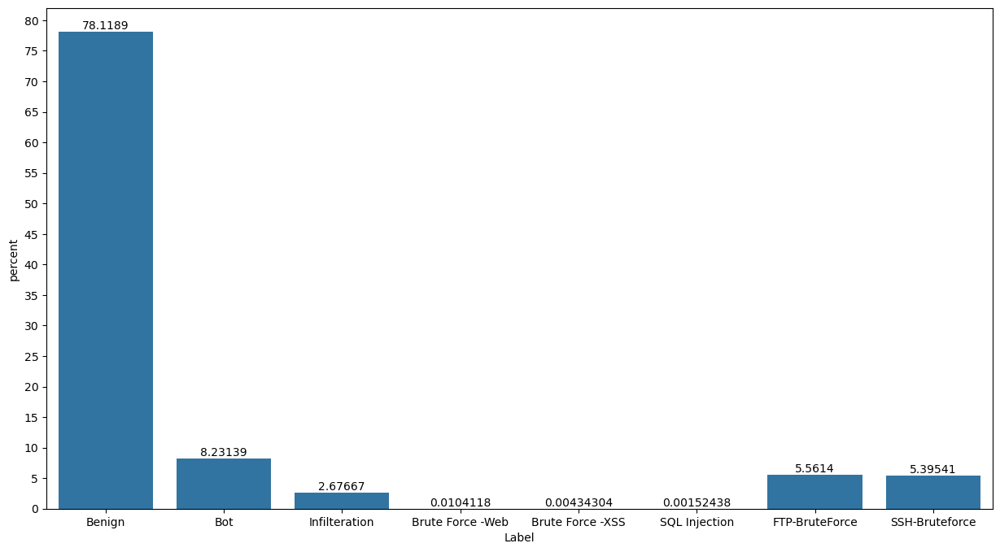

In [9]:
plt.figure(figsize=(15,8))
plt.yticks(np.arange(0,100, 5))
ax = sns.countplot(x="Label", data=dataset, stat='percent')

ax.bar_label(ax.containers[0], label_type='edge')
plt.show()

In [10]:
negative_labels = ['Brute Force -Web', 'Brute Force -XSS', 'Infilteration', 'SQL Injection', 'Bot', 'SSH-Bruteforce',
                    'FTP-BruteForce']

dataset_eda = dataset.replace(negative_labels, "Malicious")

<Axes: xlabel='Bwd Pkts/s'>

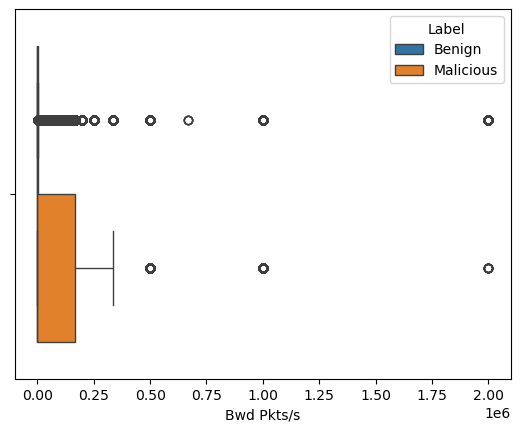

In [11]:
sns.boxplot(x="Bwd Pkts/s", hue="Label", data=dataset_eda)

<Axes: xlabel='Fwd Seg Size Min'>

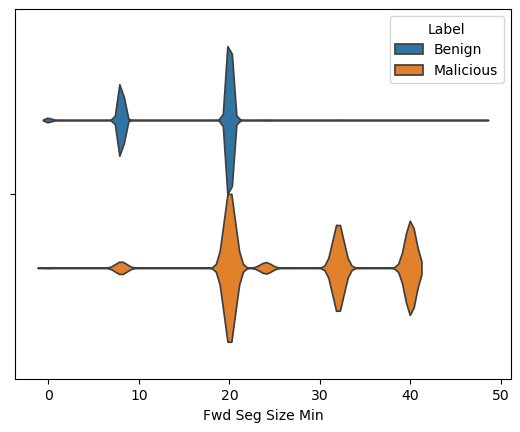

In [12]:
sns.violinplot(x="Fwd Seg Size Min", data=dataset_eda, hue="Label", inner=None)

<Axes: xlabel='Init Fwd Win Byts'>

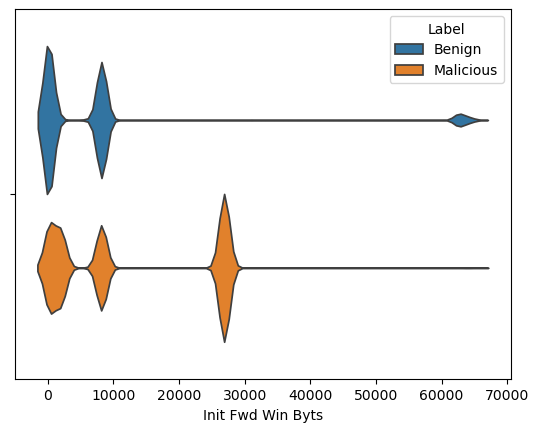

In [13]:
sns.violinplot(x="Init Fwd Win Byts", hue="Label", data=dataset_eda, inner=None)

In [14]:
dataset = dataset.drop(columns=["Timestamp", "Dst Port"])

In [15]:
dataset['Label'].unique()

array(['Benign', 'Bot', 'Infilteration', 'Brute Force -Web',
       'Brute Force -XSS', 'SQL Injection', 'FTP-BruteForce',
       'SSH-Bruteforce'], dtype=object)

In [16]:
value = 'Label'

indices_with_value = dataset.index[dataset['Label'] == value] # locate the rows with class 'Label'
indices_with_value

Index([], dtype='int64')

In [17]:
dataset = dataset.drop(indices_with_value) # remove the rows with class 'Label'

In [18]:
dataset['Label'].unique() # Now we only have the actual correct labels

array(['Benign', 'Bot', 'Infilteration', 'Brute Force -Web',
       'Brute Force -XSS', 'SQL Injection', 'FTP-BruteForce',
       'SSH-Bruteforce'], dtype=object)

In [19]:
dataset["Protocol"].unique()

array([ 6,  0, 17])

In [20]:
dataset = dataset.astype({"Protocol": str}) # Change the column data type to string
dataset["Protocol"].unique()

array(['6', '0', '17'], dtype=object)

In [21]:
dataset = pd.get_dummies(dataset, columns=['Protocol'], drop_first=True)

In [22]:

dataset.head()

,Flow Duration,Tot Fwd Pkts,Tot Bwd Pkts,TotLen Fwd Pkts,TotLen Bwd Pkts,Fwd Pkt Len Max,Fwd Pkt Len Min,Fwd Pkt Len Mean,Fwd Pkt Len Std,Bwd Pkt Len Max,...,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Label,Protocol_17,Protocol_6
0,141385,9,7,553,3773.0,202,0,61.444444,87.534438,1460,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Benign,False,True
1,281,2,1,38,0.0,38,0,19.000000,26.870058,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Benign,False,True
2,279824,11,15,1086,10527.0,385,0,98.727273,129.392497,1460,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Benign,False,True
3,132,2,0,0,0.0,0,0,0.000000,0.000000,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Benign,False,True
4,274016,9,13,1285,6141.0,517,0,142.777778,183.887722,1460,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Benign,False,True


In [23]:
num_rows_with_nan = dataset.isna().sum().sum() # Sum total number of nan values present

print("Number of rows with NaN values:", num_rows_with_nan)

Number of rows with NaN values: 10423


In [24]:
dataset.columns.to_series()[dataset.isna().any()]

Flow Byts/s    Flow Byts/s
dtype: object

In [25]:
dataset = dataset.dropna()

In [26]:
dataset = dataset.replace(np.inf, np.nan) # replace them with nan because its simpler
print("Number of rows with infinite values:", dataset.isna().sum().sum())

Number of rows with infinite values: 12156


In [27]:
dataset.columns.to_series()[dataset.isna().any()]

Flow Byts/s    Flow Byts/s
Flow Pkts/s    Flow Pkts/s
dtype: object

In [28]:
print(f'Max of Flow Bytes/s: { max(dataset["Flow Byts/s"]) }')
print(f'Max of Flow Pkts/s: { max(dataset["Flow Pkts/s"]) }')

Max of Flow Bytes/s: 850000000.0
Max of Flow Pkts/s: 4000000.0


In [29]:
#Replace 'nan' with the maximum value in its column
dataset['Flow Byts/s'] = dataset['Flow Byts/s'].replace(np.nan, max(dataset["Flow Byts/s"]))
dataset['Flow Pkts/s'] = dataset['Flow Pkts/s'].replace(np.nan, max(dataset['Flow Pkts/s']))

In [30]:
dataset.isna().sum().sum() # Check if any null values left

np.int64(0)

In [31]:
dataset.describe()

,Flow Duration,Tot Fwd Pkts,Tot Bwd Pkts,TotLen Fwd Pkts,TotLen Bwd Pkts,Fwd Pkt Len Max,Fwd Pkt Len Min,Fwd Pkt Len Mean,Fwd Pkt Len Std,Bwd Pkt Len Max,...,Fwd Act Data Pkts,Fwd Seg Size Min,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min
count,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06,...,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06,3.466402e+06
mean,1.238337e+07,6.292127e+00,7.836089e+00,4.243215e+02,6.228848e+03,1.874768e+02,1.033383e+01,4.645040e+01,6.056909e+01,3.478080e+02,...,2.344717e+00,1.878525e+01,1.029072e+05,4.930967e+04,1.650833e+05,7.167389e+04,5.802752e+06,3.204592e+05,6.405414e+06,5.410609e+06
std,6.937417e+08,8.910576e+01,2.215480e+02,1.167076e+04,3.146808e+05,2.765034e+02,2.577797e+01,5.662378e+01,9.142360e+01,5.080336e+02,...,1.548496e+01,8.319987e+00,1.615051e+06,9.605888e+05,2.157299e+06,1.375186e+06,2.983353e+08,2.101050e+08,8.373478e+08,2.029158e+07
min,-9.190110e+11,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,3.090000e+02,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,2.000000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,1.223700e+04,2.000000e+00,1.000000e+00,4.400000e+01,9.500000e+01,4.000000e+01,0.000000e+00,3.500000e+01,0.000000e+00,8.400000e+01,...,0.000000e+00,2.000000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
75%,2.550098e+06,7.000000e+00,6.000000e+00,4.450000e+02,5.820000e+02,3.260000e+02,0.000000e+00,7.380000e+01,1.120060e+02,4.880000e+02,...,4.000000e+00,2.000000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
max,1.200000e+08,5.809100e+04,1.231180e+05,9.789747e+06,1.563604e+08,6.444000e+04,1.460000e+03,1.121703e+04,1.576084e+04,6.516000e+04,...,1.829000e+04,4.800000e+01,1.140000e+08,7.490000e+07,1.140000e+08,1.140000e+08,3.394503e+11,2.432682e+11,9.797810e+11,1.260300e+10


In [32]:
dataset["Label"].value_counts()

Label
Benign              2706068
Bot                  286191
FTP-BruteForce       193354
SSH-Bruteforce       187589
Infilteration         92634
Brute Force -Web        362
Brute Force -XSS        151
SQL Injection            53
Name: count, dtype: int64

In [33]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
le.fit(dataset['Label'])

mapping = dict(zip(le.classes_, le.transform(le.classes_)))
dataset["Label"] = le.transform(dataset["Label"])

mapping

{'Benign': np.int64(0),
 'Bot': np.int64(1),
 'Brute Force -Web': np.int64(2),
 'Brute Force -XSS': np.int64(3),
 'FTP-BruteForce': np.int64(4),
 'Infilteration': np.int64(5),
 'SQL Injection': np.int64(6),
 'SSH-Bruteforce': np.int64(7)}

In [34]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3466402 entries, 0 to 3476824
Data columns (total 79 columns):
 #   Column             Dtype  
---  ------             -----  
 0   Flow Duration      int64  
 1   Tot Fwd Pkts       int64  
 2   Tot Bwd Pkts       int64  
 3   TotLen Fwd Pkts    int64  
 4   TotLen Bwd Pkts    float64
 5   Fwd Pkt Len Max    int64  
 6   Fwd Pkt Len Min    int64  
 7   Fwd Pkt Len Mean   float64
 8   Fwd Pkt Len Std    float64
 9   Bwd Pkt Len Max    int64  
 10  Bwd Pkt Len Min    int64  
 11  Bwd Pkt Len Mean   float64
 12  Bwd Pkt Len Std    float64
 13  Flow Byts/s        float64
 14  Flow Pkts/s        float64
 15  Flow IAT Mean      float64
 16  Flow IAT Std       float64
 17  Flow IAT Max       float64
 18  Flow IAT Min       float64
 19  Fwd IAT Tot        float64
 20  Fwd IAT Mean       float64
 21  Fwd IAT Std        float64
 22  Fwd IAT Max        float64
 23  Fwd IAT Min        float64
 24  Bwd IAT Tot        float64
 25  Bwd IAT Mean       floa

In [35]:
dataset = dataset[dataset.ge(0).all(axis=1)]

In [36]:
dataset

,Flow Duration,Tot Fwd Pkts,Tot Bwd Pkts,TotLen Fwd Pkts,TotLen Bwd Pkts,Fwd Pkt Len Max,Fwd Pkt Len Min,Fwd Pkt Len Mean,Fwd Pkt Len Std,Bwd Pkt Len Max,...,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Label,Protocol_17,Protocol_6
0,141385,9,7,553,3773.0,202,0,61.444444,87.534438,1460,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,False,True
1,281,2,1,38,0.0,38,0,19.000000,26.870058,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,False,True
2,279824,11,15,1086,10527.0,385,0,98.727273,129.392497,1460,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,False,True
4,274016,9,13,1285,6141.0,517,0,142.777778,183.887722,1460,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,False,True
6,5964033,3,1,0,0.0,0,0,0.000000,0.000000,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3476818,10056041,5,5,1136,2668.0,578,0,227.200000,311.186761,1334,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,False,True
3476820,10156986,5,5,1089,1923.0,587,0,217.800000,299.745225,1334,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,False,True
3476822,5095331,3,1,0,0.0,0,0,0.000000,0.000000,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,False,True
3476823,5235511,3,1,0,0.0,0,0,0.000000,0.000000,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,False,True


In [37]:
print(f"Number of duplicates is: {dataset.duplicated().sum().sum()}")

Number of duplicates is: 407231


In [38]:
dataset = dataset.drop_duplicates(ignore_index=True)

In [39]:
dataset.shape

(1475212, 79)

In [40]:
features = ['Flow Duration', 'Tot Fwd Pkts', 'Tot Bwd Pkts',
       'TotLen Fwd Pkts', 'TotLen Bwd Pkts', 'Fwd Pkt Len Max',
       'Fwd Pkt Len Min', 'Fwd Pkt Len Mean', 'Fwd Pkt Len Std',
       'Bwd Pkt Len Max', 'Bwd Pkt Len Min', 'Bwd Pkt Len Mean',
       'Bwd Pkt Len Std', 'Flow Byts/s', 'Flow Pkts/s', 'Flow IAT Mean',
       'Flow IAT Std', 'Flow IAT Max', 'Flow IAT Min', 'Fwd IAT Tot',
       'Fwd IAT Mean', 'Fwd IAT Std', 'Fwd IAT Max', 'Fwd IAT Min',
       'Bwd IAT Tot', 'Bwd IAT Mean', 'Bwd IAT Std', 'Bwd IAT Max',
       'Bwd IAT Min', 'Fwd PSH Flags', 'Bwd PSH Flags', 'Fwd URG Flags',
       'Bwd URG Flags', 'Fwd Header Len', 'Bwd Header Len', 'Fwd Pkts/s',
       'Bwd Pkts/s', 'Pkt Len Min', 'Pkt Len Max', 'Pkt Len Mean',
       'Pkt Len Std', 'Pkt Len Var', 'FIN Flag Cnt', 'SYN Flag Cnt',
       'RST Flag Cnt', 'PSH Flag Cnt', 'ACK Flag Cnt', 'URG Flag Cnt',
       'CWE Flag Count', 'ECE Flag Cnt', 'Down/Up Ratio', 'Pkt Size Avg',
       'Fwd Seg Size Avg', 'Bwd Seg Size Avg', 'Fwd Byts/b Avg',
       'Fwd Pkts/b Avg', 'Fwd Blk Rate Avg', 'Bwd Byts/b Avg',
       'Bwd Pkts/b Avg', 'Bwd Blk Rate Avg', 'Subflow Fwd Pkts',
       'Subflow Fwd Byts', 'Subflow Bwd Pkts', 'Subflow Bwd Byts',
       'Init Fwd Win Byts', 'Init Bwd Win Byts', 'Fwd Act Data Pkts',
       'Fwd Seg Size Min', 'Active Mean', 'Active Std', 'Active Max',
       'Active Min', 'Idle Mean', 'Idle Std', 'Idle Max', 'Idle Min',
       'Protocol_17', 'Protocol_6', 'Label']

dataset = dataset[features]
dataset.columns

Index(['Flow Duration', 'Tot Fwd Pkts', 'Tot Bwd Pkts', 'TotLen Fwd Pkts',
       'TotLen Bwd Pkts', 'Fwd Pkt Len Max', 'Fwd Pkt Len Min',
       'Fwd Pkt Len Mean', 'Fwd Pkt Len Std', 'Bwd Pkt Len Max',
       'Bwd Pkt Len Min', 'Bwd Pkt Len Mean', 'Bwd Pkt Len Std', 'Flow Byts/s',
       'Flow Pkts/s', 'Flow IAT Mean', 'Flow IAT Std', 'Flow IAT Max',
       'Flow IAT Min', 'Fwd IAT Tot', 'Fwd IAT Mean', 'Fwd IAT Std',
       'Fwd IAT Max', 'Fwd IAT Min', 'Bwd IAT Tot', 'Bwd IAT Mean',
       'Bwd IAT Std', 'Bwd IAT Max', 'Bwd IAT Min', 'Fwd PSH Flags',
       'Bwd PSH Flags', 'Fwd URG Flags', 'Bwd URG Flags', 'Fwd Header Len',
       'Bwd Header Len', 'Fwd Pkts/s', 'Bwd Pkts/s', 'Pkt Len Min',
       'Pkt Len Max', 'Pkt Len Mean', 'Pkt Len Std', 'Pkt Len Var',
       'FIN Flag Cnt', 'SYN Flag Cnt', 'RST Flag Cnt', 'PSH Flag Cnt',
       'ACK Flag Cnt', 'URG Flag Cnt', 'CWE Flag Count', 'ECE Flag Cnt',
       'Down/Up Ratio', 'Pkt Size Avg', 'Fwd Seg Size Avg', 'Bwd Seg Size Avg',
   

In [41]:
dataset

,Flow Duration,Tot Fwd Pkts,Tot Bwd Pkts,TotLen Fwd Pkts,TotLen Bwd Pkts,Fwd Pkt Len Max,Fwd Pkt Len Min,Fwd Pkt Len Mean,Fwd Pkt Len Std,Bwd Pkt Len Max,...,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Protocol_17,Protocol_6,Label
0,141385,9,7,553,3773.0,202,0,61.444444,87.534438,1460,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,False,True,0
1,281,2,1,38,0.0,38,0,19.000000,26.870058,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,False,True,0
2,279824,11,15,1086,10527.0,385,0,98.727273,129.392497,1460,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,False,True,0
3,274016,9,13,1285,6141.0,517,0,142.777778,183.887722,1460,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,False,True,0
4,5964033,3,1,0,0.0,0,0,0.000000,0.000000,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,False,True,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1475207,10056041,5,5,1136,2668.0,578,0,227.200000,311.186761,1334,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,False,True,0
1475208,10156986,5,5,1089,1923.0,587,0,217.800000,299.745225,1334,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,False,True,0
1475209,5095331,3,1,0,0.0,0,0,0.000000,0.000000,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,False,True,0
1475210,5235511,3,1,0,0.0,0,0,0.000000,0.000000,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,False,True,0


In [42]:
dataset['Label'].value_counts()

Label
0    1207489
1     143014
7      94043
5      30380
2        125
3         73
4         53
6         35
Name: count, dtype: int64

In [43]:
X, y = dataset.drop('Label', axis=1), dataset['Label']

In [44]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

In [45]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [46]:
X_train_scaled

array([[-0.47074023,  0.08451709,  0.01347516, ..., -0.32542776,
         0.        ,  0.        ],
       [-0.47502106, -0.06792026, -0.04686265, ..., -0.32542776,
         0.        ,  0.        ],
       [-0.4780212 , -0.07517918, -0.04686265, ..., -0.32542776,
         0.        ,  0.        ],
       ...,
       [-0.47036785,  0.06999924,  0.01347516, ..., -0.32542776,
         0.        ,  0.        ],
       [-0.44743862, -0.03162565, -0.02962328, ..., -0.32542776,
         0.        ,  0.        ],
       [-0.43591953, -0.03162565, -0.02962328, ..., -0.32542776,
         0.        ,  0.        ]])

In [47]:
from sklearn.feature_selection import SelectKBest, f_classif
selector = SelectKBest(score_func=f_classif, k=10)
X_train_sel = selector.fit_transform(X_train_scaled, y_train)
X_test_sel = selector.transform(X_test_scaled)
if hasattr(X, 'columns'):
    selected_features = X.columns[selector.get_support()]
    print("Selected Features:\n", selected_features.tolist())

Selected Features:
 ['Bwd Pkt Len Max', 'Bwd Pkt Len Mean', 'Bwd Pkt Len Std', 'Pkt Len Max', 'RST Flag Cnt', 'ECE Flag Cnt', 'Init Fwd Win Byts', 'Init Bwd Win Byts', 'Fwd Act Data Pkts', 'Fwd Seg Size Min']


In [48]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline

# ✅ Define separate strategies
over_strategy = {
    2: 500,
    3: 300,
    4: 300,
    6: 300,
    7: 94043,
    1: 143014,
}

# ✅ Define undersampling (only for class 0)
under_strategy = {0: 300000}

# Create samplers
over = SMOTE(random_state=42, sampling_strategy=over_strategy)
under = RandomUnderSampler(random_state=42, sampling_strategy=under_strategy)

# Combine them in sequence: first SMOTE, then under-sample
resample_pipeline = Pipeline(steps=[('o', over), ('u', under)])

# Apply to training set
X_train_res, y_train_res = resample_pipeline.fit_resample(X_train, y_train)

# Check results
print("\nBefore resampling:", y_train.value_counts().to_dict())
print("After resampling:", pd.Series(y_train_res).value_counts().to_dict())




Before resampling: {0: 965991, 1: 114411, 7: 75234, 5: 24304, 2: 100, 3: 58, 4: 43, 6: 28}
After resampling: {0: 300000, 1: 143014, 7: 94043, 5: 24304, 2: 500, 3: 300, 4: 300, 6: 300}


In [49]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score
rf_model = RandomForestClassifier(
    n_estimators=500,
    max_depth=None,
    min_samples_split=5,
    min_samples_leaf=1,
    max_features='log2',
    class_weight='balanced',  # <- THIS handles the extreme minority classes
    random_state=42,
    n_jobs=-1
)

rf_model.fit(X_train_res, y_train_res)

# 6️⃣ Evaluate
y_pred_rf = rf_model.predict(X_test)
print(classification_report(y_test, y_pred_rf))

              precision    recall  f1-score   support

           0       0.99      0.97      0.98    241498
           1       1.00      1.00      1.00     28603
           2       1.00      1.00      1.00        25
           3       1.00      1.00      1.00        15
           4       0.56      0.90      0.69        10
           5       0.28      0.43      0.34      6076
           6       1.00      0.71      0.83         7
           7       1.00      1.00      1.00     18809

    accuracy                           0.97    295043
   macro avg       0.85      0.88      0.86    295043
weighted avg       0.97      0.97      0.97    295043



In [50]:
from sklearn.metrics import confusion_matrix

conf_matrix = confusion_matrix(y_test, y_pred_rf)

df_matrix = pd.DataFrame(conf_matrix, index=mapping.keys(), columns=mapping.keys())
df_matrix

,Benign,Bot,Brute Force -Web,Brute Force -XSS,FTP-BruteForce,Infilteration,SQL Injection,SSH-Bruteforce
Benign,234738,0,0,0,5,6753,0,2
Bot,1,28602,0,0,0,0,0,0
Brute Force -Web,0,0,25,0,0,0,0,0
Brute Force -XSS,0,0,0,15,0,0,0,0
FTP-BruteForce,0,0,0,0,9,0,0,1
Infilteration,3479,0,0,0,0,2597,0,0
SQL Injection,2,0,0,0,0,0,5,0
SSH-Bruteforce,1,0,0,0,2,0,0,18806


In [51]:
import lightgbm as lgb
from sklearn.utils.class_weight import compute_sample_weight
from sklearn.metrics import classification_report

# Compute class balancing weights
sample_weights = compute_sample_weight(class_weight='balanced', y=y_train_res)

# Initialize LightGBM model
lgb_model = lgb.LGBMClassifier(
    n_estimators=500,
    max_depth=-1,               # -1 means no limit
    learning_rate=0.05,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42,
    n_jobs=-1,
    boosting_type='gbdt'
)

# Fit model
lgb_model.fit(X_train_res, y_train_res, sample_weight=sample_weights)

# Predict
y_pred_lgb = lgb_model.predict(X_test)

# Evaluate
print(classification_report(y_test, y_pred_lgb, target_names=[str(c) for c in np.unique(y_test)]))


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.032402 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 13319
[LightGBM] [Info] Number of data points in the train set: 562761, number of used features: 68
[LightGBM] [Info] Start training from score -2.079442
[LightGBM] [Info] Start training from score -2.079442
[LightGBM] [Info] Start training from score -2.079442
[LightGBM] [Info] Start training from score -2.079442
[LightGBM] [Info] Start training from score -2.079442
[LightGBM] [Info] Start training from score -2.079442
[LightGBM] [Info] Start training from score -2.079442
[LightGBM] [Info] Start training from score -2.079442
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

In [52]:
from sklearn.metrics import confusion_matrix

conf_matrix = confusion_matrix(y_test, y_pred_lgb)

df_matrix = pd.DataFrame(conf_matrix, index=mapping.keys(), columns=mapping.keys())
df_matrix

,Benign,Bot,Brute Force -Web,Brute Force -XSS,FTP-BruteForce,Infilteration,SQL Injection,SSH-Bruteforce
Benign,208838,1,2,0,0,32655,0,2
Bot,1,28601,0,0,0,1,0,0
Brute Force -Web,0,0,25,0,0,0,0,0
Brute Force -XSS,0,0,0,15,0,0,0,0
FTP-BruteForce,0,0,0,0,10,0,0,0
Infilteration,492,0,0,0,0,5584,0,0
SQL Injection,0,0,0,0,0,0,7,0
SSH-Bruteforce,0,0,0,0,2,0,0,18807


In [53]:
import xgboost as xgb
from sklearn.utils.class_weight import compute_sample_weight
from sklearn.metrics import classification_report

# Compute sample weights to balance classes
sample_weights = compute_sample_weight(class_weight='balanced', y=y_train_res)

# Initialize XGBoost model
xgb_model = xgb.XGBClassifier(
    n_estimators=500,
    max_depth=6,
    learning_rate=0.1,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42,
    n_jobs=-1,
    tree_method='hist'
)

# Fit model using sample weights
xgb_model.fit(X_train_res, y_train_res, sample_weight=sample_weights)

# Predict on test set
y_pred_xgb = xgb_model.predict(X_test)

# Evaluate
print(classification_report(y_test, y_pred_xgb))

              precision    recall  f1-score   support

           0       1.00      0.87      0.93    241498
           1       1.00      1.00      1.00     28603
           2       0.83      1.00      0.91        25
           3       1.00      1.00      1.00        15
           4       0.69      0.90      0.78        10
           5       0.14      0.89      0.25      6076
           6       1.00      1.00      1.00         7
           7       1.00      1.00      1.00     18809

    accuracy                           0.89    295043
   macro avg       0.83      0.96      0.86    295043
weighted avg       0.98      0.89      0.92    295043



In [54]:
from sklearn.metrics import confusion_matrix

conf_matrix = confusion_matrix(y_test, y_pred_xgb)

df_matrix = pd.DataFrame(conf_matrix, index=mapping.keys(), columns=mapping.keys())
df_matrix

,Benign,Bot,Brute Force -Web,Brute Force -XSS,FTP-BruteForce,Infilteration,SQL Injection,SSH-Bruteforce
Benign,209065,0,5,0,2,32423,0,3
Bot,0,28602,0,0,0,1,0,0
Brute Force -Web,0,0,25,0,0,0,0,0
Brute Force -XSS,0,0,0,15,0,0,0,0
FTP-BruteForce,0,0,0,0,9,0,0,1
Infilteration,675,0,0,0,0,5401,0,0
SQL Injection,0,0,0,0,0,0,7,0
SSH-Bruteforce,0,0,0,0,2,0,0,18807


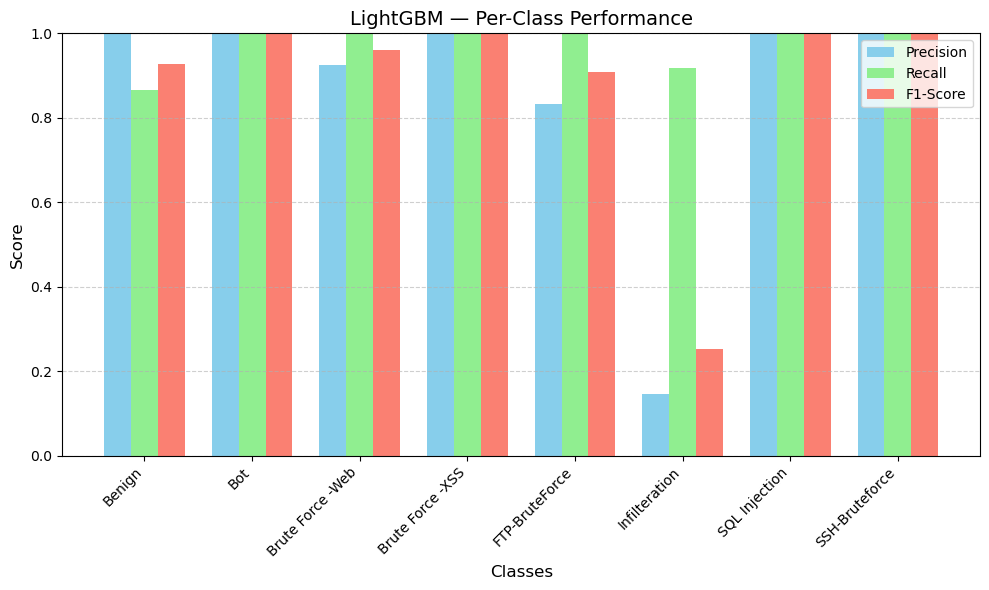

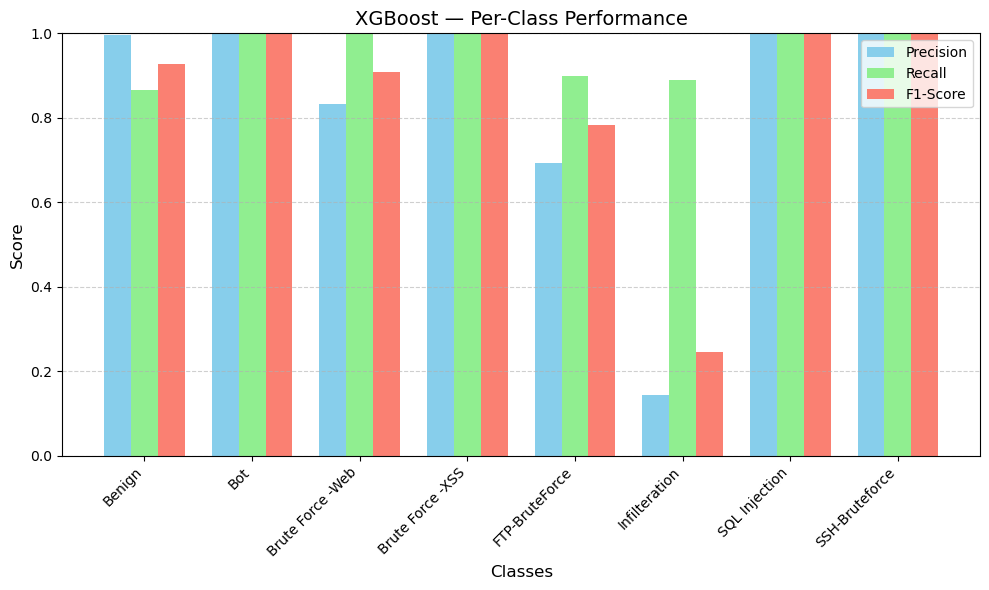

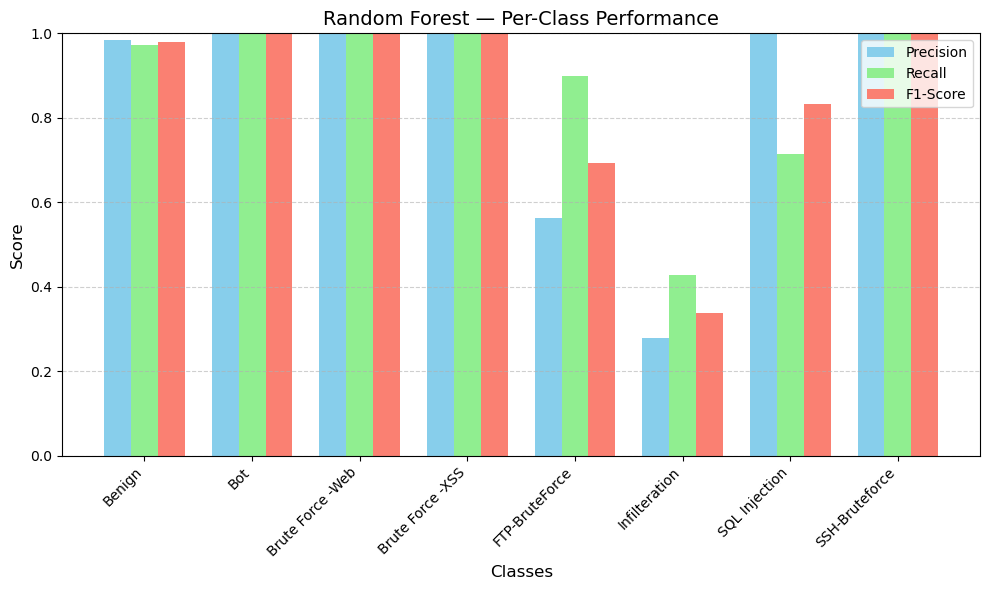

In [55]:
import matplotlib.pyplot as plt
import numpy as np
report_lgb = classification_report(y_test, y_pred_lgb, output_dict=True)
report_xgb = classification_report(y_test, y_pred_xgb, output_dict=True)
report_rf = classification_report(y_test, y_pred_rf, output_dict=True)
# Assuming you already have:
# report_lgb, report_xgb, report_rf  (from classification_report(..., output_dict=True))
# and a fitted LabelEncoder called 'le'

# Extract numeric class labels from classification report (ignore averages)
numeric_labels = [label for label in report_lgb.keys() if label not in ['accuracy', 'macro avg', 'weighted avg']]

# Convert numeric labels to original class names using the label encoder
class_labels = [le.classes_[int(l)] for l in numeric_labels]

# Function to plot all metrics together for one model
def plot_combined_metrics(report, model_name):
    precision = [report[c]['precision'] for c in numeric_labels]
    recall = [report[c]['recall'] for c in numeric_labels]
    f1 = [report[c]['f1-score'] for c in numeric_labels]

    x = np.arange(len(class_labels))
    bar_width = 0.25

    plt.figure(figsize=(10, 6))
    plt.bar(x - bar_width, precision, width=bar_width, label='Precision', color='skyblue')
    plt.bar(x, recall, width=bar_width, label='Recall', color='lightgreen')
    plt.bar(x + bar_width, f1, width=bar_width, label='F1-Score', color='salmon')

    plt.xticks(x, class_labels, rotation=45, ha='right')
    plt.ylim(0, 1)
    plt.title(f'{model_name} — Per-Class Performance', fontsize=14)
    plt.xlabel('Classes', fontsize=12)
    plt.ylabel('Score', fontsize=12)
    plt.legend()
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()

# Generate one combined chart per classifier
plot_combined_metrics(report_lgb, 'LightGBM')
plot_combined_metrics(report_xgb, 'XGBoost')
plot_combined_metrics(report_rf, 'Random Forest')


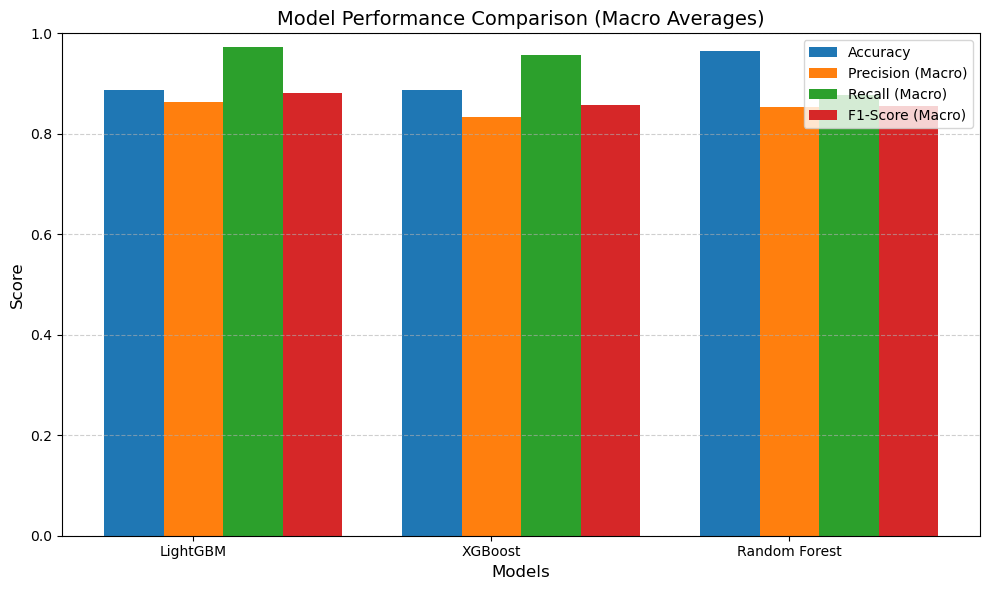

In [56]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report

# Assuming you've already predicted once and stored predictions:
# y_pred_lgb, y_pred_xgb, y_pred_rf

# Create classification reports
report_lgb = classification_report(y_test, y_pred_lgb, output_dict=True)
report_xgb = classification_report(y_test, y_pred_xgb, output_dict=True)
report_rf  = classification_report(y_test, y_pred_rf,  output_dict=True)

# Model names
models = ['LightGBM', 'XGBoost', 'Random Forest']

# Extract metrics (using MACRO average)
accuracy = [
    report_lgb['accuracy'],
    report_xgb['accuracy'],
    report_rf['accuracy']
]

precision = [
    report_lgb['macro avg']['precision'],
    report_xgb['macro avg']['precision'],
    report_rf['macro avg']['precision']
]

recall = [
    report_lgb['macro avg']['recall'],
    report_xgb['macro avg']['recall'],
    report_rf['macro avg']['recall']
]

f1 = [
    report_lgb['macro avg']['f1-score'],
    report_xgb['macro avg']['f1-score'],
    report_rf['macro avg']['f1-score']
]

# Combine into a single array
metrics = np.array([accuracy, precision, recall, f1])
metric_names = ['Accuracy', 'Precision (Macro)', 'Recall (Macro)', 'F1-Score (Macro)']

# Plot grouped bar chart
x = np.arange(len(models))
bar_width = 0.2

plt.figure(figsize=(10, 6))
for i in range(len(metric_names)):
    plt.bar(x + i * bar_width, metrics[i], width=bar_width, label=metric_names[i])

plt.xlabel('Models', fontsize=12)
plt.ylabel('Score', fontsize=12)
plt.title('Model Performance Comparison (Macro Averages)', fontsize=14)
plt.xticks(x + bar_width, models)
plt.ylim(0, 1)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()


Evaluating Random Forest...
Evaluating XGBoost...
Evaluating LightGBM...


,Accuracy,Balanced Accuracy,Precision (Macro),Recall (Macro),F1 (Macro),Precision (Weighted),Recall (Weighted),F1 (Weighted),Cohen Kappa,Train Time (s),PR-AUC (Macro),PR-AUC (Weighted),Log Loss
Model,,,,,,,,,,,,,
Random Forest,0.965273,0.876690,0.853184,0.876690,0.855102,0.973134,0.965273,0.968837,0.893149,7.751908,0.883858,0.984699,0.092692
XGBoost,0.887772,0.956808,0.833125,0.956808,0.858026,0.979675,0.887772,0.924391,0.720847,2.693092,0.895703,0.986080,0.232047
LightGBM,0.887623,0.972951,0.862848,0.972951,0.881118,0.980464,0.887623,0.924386,0.721243,8.895186,0.916537,0.986360,0.223836


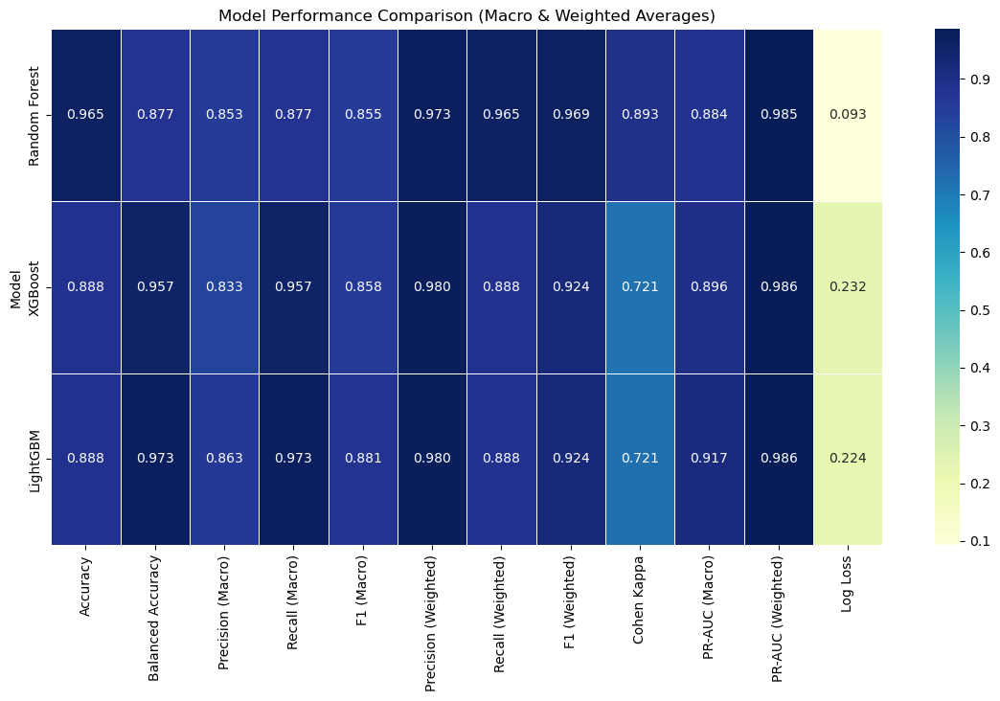

<Figure size 500x400 with 0 Axes>

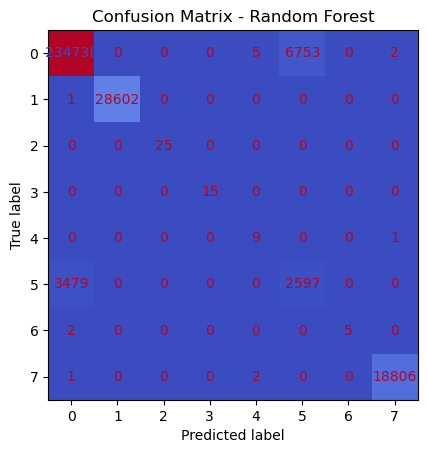

<Figure size 500x400 with 0 Axes>

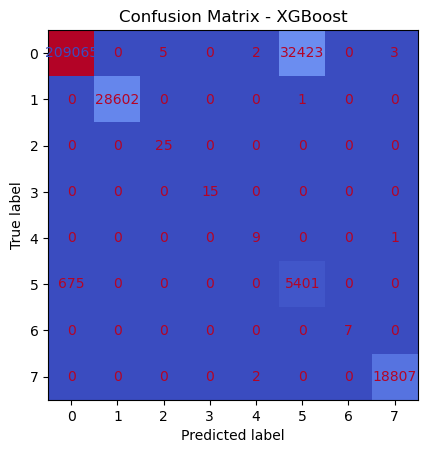

<Figure size 500x400 with 0 Axes>

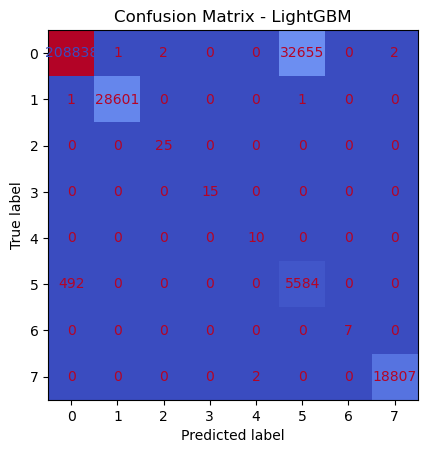

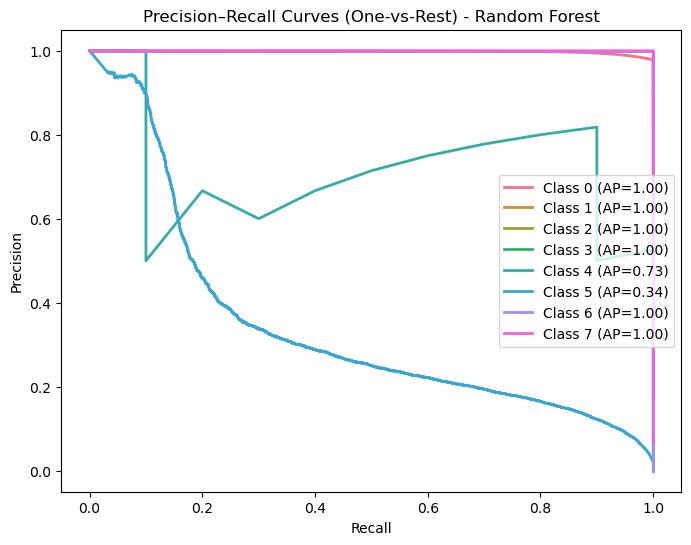

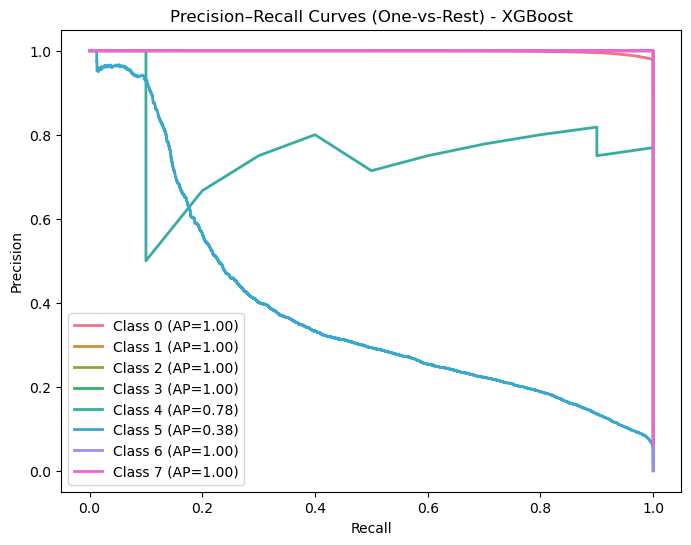

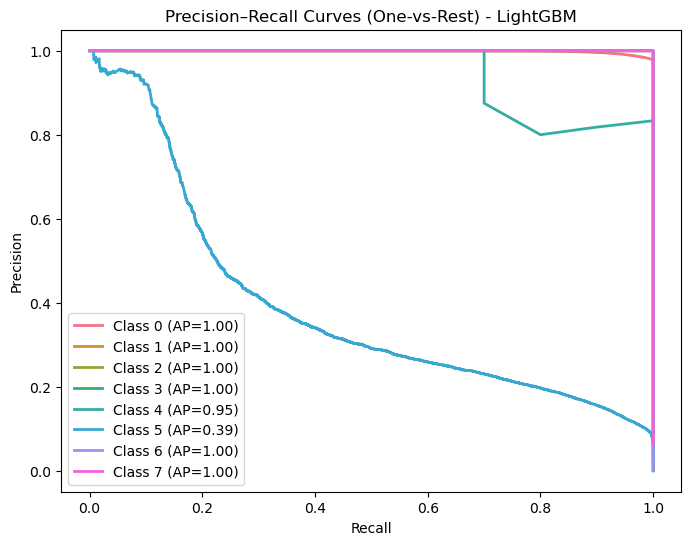

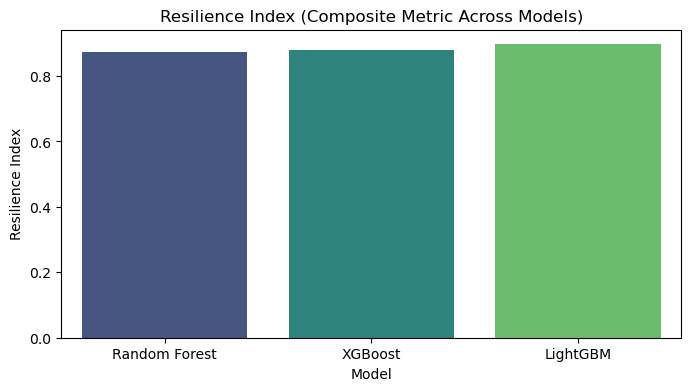

T-test skipped due to missing models or NaN values.
🏆 Best Performing Model: LightGBM

Performance Summary:
Accuracy                0.887623
Balanced Accuracy       0.972951
Precision (Macro)       0.862848
Recall (Macro)          0.972951
F1 (Macro)              0.881118
Precision (Weighted)    0.980464
Recall (Weighted)       0.887623
F1 (Weighted)           0.924386
Cohen Kappa             0.721243
Train Time (s)          8.895186
PR-AUC (Macro)          0.916537
PR-AUC (Weighted)       0.986360
Log Loss                0.223836
Resilience Index        0.896860
Name: LightGBM, dtype: float64


In [57]:
# ================================================
# 📊 ADVANCED MULTI-CLASS MODEL EVALUATION & VISUAL COMPARISON (with PR Curves)
# ================================================
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import time
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    balanced_accuracy_score, cohen_kappa_score, log_loss,
    ConfusionMatrixDisplay, precision_recall_curve, average_precision_score
)
from sklearn.preprocessing import label_binarize
from scipy.stats import ttest_rel
from itertools import cycle

# ----------------------------------------
# STEP 1: Unified evaluation (multi-class)
# ----------------------------------------
def evaluate_model(model, X_test, y_test, model_name="Model"):
    start = time.time()
    y_pred = model.predict(X_test)
    end = time.time()

    metrics = {
        "Model": model_name,
        "Accuracy": accuracy_score(y_test, y_pred),
        "Balanced Accuracy": balanced_accuracy_score(y_test, y_pred),
        "Precision (Macro)": precision_score(y_test, y_pred, average='macro', zero_division=0),
        "Recall (Macro)": recall_score(y_test, y_pred, average='macro', zero_division=0),
        "F1 (Macro)": f1_score(y_test, y_pred, average='macro', zero_division=0),
        "Precision (Weighted)": precision_score(y_test, y_pred, average='weighted', zero_division=0),
        "Recall (Weighted)": recall_score(y_test, y_pred, average='weighted', zero_division=0),
        "F1 (Weighted)": f1_score(y_test, y_pred, average='weighted', zero_division=0),
        "Cohen Kappa": cohen_kappa_score(y_test, y_pred),
        "Train Time (s)": end - start
    }

    # Probability-based metrics for PR-AUC and log loss
    if hasattr(model, "predict_proba"):
        try:
            y_prob = model.predict_proba(X_test)
            y_bin = label_binarize(y_test, classes=np.unique(y_test))
            metrics["PR-AUC (Macro)"] = average_precision_score(y_bin, y_prob, average='macro')
            metrics["PR-AUC (Weighted)"] = average_precision_score(y_bin, y_prob, average='weighted')
            metrics["Log Loss"] = log_loss(y_test, y_prob)
        except Exception as e:
            print(f"[Warning] PR-AUC skipped for {model_name}: {e}")
            metrics["PR-AUC (Macro)"] = np.nan
            metrics["PR-AUC (Weighted)"] = np.nan
            metrics["Log Loss"] = np.nan
    else:
        metrics["PR-AUC (Macro)"] = np.nan
        metrics["PR-AUC (Weighted)"] = np.nan
        metrics["Log Loss"] = np.nan

    return metrics


# ----------------------------------------
# STEP 2: Evaluate all trained models
# ----------------------------------------
models = {
    "Random Forest": rf_model,
    "XGBoost": xgb_model,
    "LightGBM": lgb_model
}

results = []
for name, model in models.items():
    print(f"Evaluating {name}...")
    results.append(evaluate_model(model, X_test, y_test, model_name=name))

results_df = pd.DataFrame(results).set_index("Model")
display(results_df.style.background_gradient(cmap="YlGnBu", axis=None))

# ----------------------------------------
# STEP 3: Quantitative Comparison Heatmap
# ----------------------------------------
plt.figure(figsize=(14,7))
sns.heatmap(results_df.drop(columns=["Train Time (s)"], errors='ignore').astype(float),
            annot=True, fmt=".3f", cmap="YlGnBu", linewidths=.5)
plt.title("Model Performance Comparison (Macro & Weighted Averages)")
plt.show()

# ----------------------------------------
# STEP 4: Confusion Matrices
# ----------------------------------------
for name, model in models.items():
    y_pred = model.predict(X_test)
    plt.figure(figsize=(5,4))
    ConfusionMatrixDisplay.from_predictions(y_test, y_pred, cmap='coolwarm', colorbar=False)
    plt.title(f"Confusion Matrix - {name}")
    plt.show()

# ----------------------------------------
# STEP 5: Multi-Class Precision–Recall Curves
# ----------------------------------------
classes = np.unique(y_test)
n_classes = len(classes)

for name, model in models.items():
    if hasattr(model, "predict_proba"):
        try:
            y_prob = model.predict_proba(X_test)
            y_bin = label_binarize(y_test, classes=classes)
            plt.figure(figsize=(8,6))
            colors = cycle(sns.color_palette("husl", n_classes))
            for i, color in zip(range(n_classes), colors):
                precision, recall, _ = precision_recall_curve(y_bin[:, i], y_prob[:, i])
                ap = average_precision_score(y_bin[:, i], y_prob[:, i])
                plt.plot(recall, precision, lw=2, color=color,
                         label=f'Class {classes[i]} (AP={ap:.2f})')
            plt.title(f"Precision–Recall Curves (One-vs-Rest) - {name}")
            plt.xlabel("Recall")
            plt.ylabel("Precision")
            plt.legend()
            plt.show()
        except Exception as e:
            print(f"[Warning] PR curve skipped for {name}: {e}")

# ----------------------------------------
# STEP 6: Resilience Index (Composite Metric)
# ----------------------------------------
if "Log Loss" in results_df.columns:
    results_df["Resilience Index"] = (
        0.4 * results_df["Recall (Macro)"] +
        0.4 * results_df["F1 (Macro)"] +
        0.2 * (1 - results_df["Log Loss"].fillna(0))
    )
    plt.figure(figsize=(8,4))
    sns.barplot(x=results_df.index, y=results_df["Resilience Index"], palette="viridis")
    plt.title("Resilience Index (Composite Metric Across Models)")
    plt.show()

# ----------------------------------------
# STEP 7: Statistical Significance (Optional)
# ----------------------------------------
try:
    t_stat, p_val = ttest_rel(results_df.loc["Random Forest"], results_df.loc["Decision Tree"])
    print(f"T-test RF vs DT: t-stat={t_stat:.3f}, p-value={p_val:.3f}")
except Exception:
    print("T-test skipped due to missing models or NaN values.")

# ----------------------------------------
# STEP 8: Insights Summary
# ----------------------------------------
best_model = results_df["F1 (Macro)"].idxmax()
print("🏆 Best Performing Model:", best_model)
print("\nPerformance Summary:")
print(results_df.loc[best_model])


## ☁️ Autonomous Cloud Resilience Dashboard

This visualization demonstrates the **autonomous resilience behavior** of a cloud-based machine learning system under continuous cyberattacks.  
The system self-recovers from various intrusion attempts, modeled as attack predictions (`y_pred`), and dynamically maintains its resilience score over time.

---

### 🔍 Description

- **Resilience (Smoothed Curve)** — Represents the overall system health and stability (on a scale of 0–100).  
  A higher score indicates stronger recovery and better adaptation to failures and attacks.
  
- **Detected Attacks (Red Markers)** — Points where malicious events were detected, such as brute-force or infiltration attempts.  
  These attacks cause temporary dips in resilience before recovery mechanisms activate.

- **Colored Zones:**
  - 🟩 **Green (80–100):** Stable operational state — optimal performance.
  - 🟨 **Yellow (50–80):** Transitional state — recovery in progress.
  - 🟥 **Red (0–50):** Critical instability — major failure or sustained attack impact.

---

### 📊 Key Metrics

| Metric | Meaning | Example |
|:--|:--|:--|
| **MTTR (Mean Time To Recovery)** | Average time (in instances) it takes to restore resilience above the 90 threshold after a drop below 70. | `40.86 instances` |
| **Average Resilience** | Mean system resilience score across all instances. | `91.99` |
| **Total Attacks** | Count of detected malicious events or anomalies. | `85,303` |
| **Stable Time** | Percentage of time the system operated in the stable (green) zone. | `89.1%` |

---

### 💡 Interpretation

A high average resilience (≈92) and stable time (>85%) indicate a **strongly self-healing** cloud infrastructure capable of maintaining operational stability even during frequent attacks.  
Shorter MTTR values represent **faster recovery cycles**, enhancing service availability and reliability.

---

### ⚙️ Visualization Features

- **Smoothed Resilience Line** (in blue) highlights long-term recovery trends.  
- **Transparent Attack Markers** (in red) prevent visual clutter on large datasets.  
- **Dynamic Scaling** — automatically samples a subset of attack events for better visibility when dataset size exceeds 5,000 points.  
- **Color-coded Stability Zones** clearly communicate resilience states at a glance.

---

_Run the code cell below to generate the live interactive Plotly dashboard._


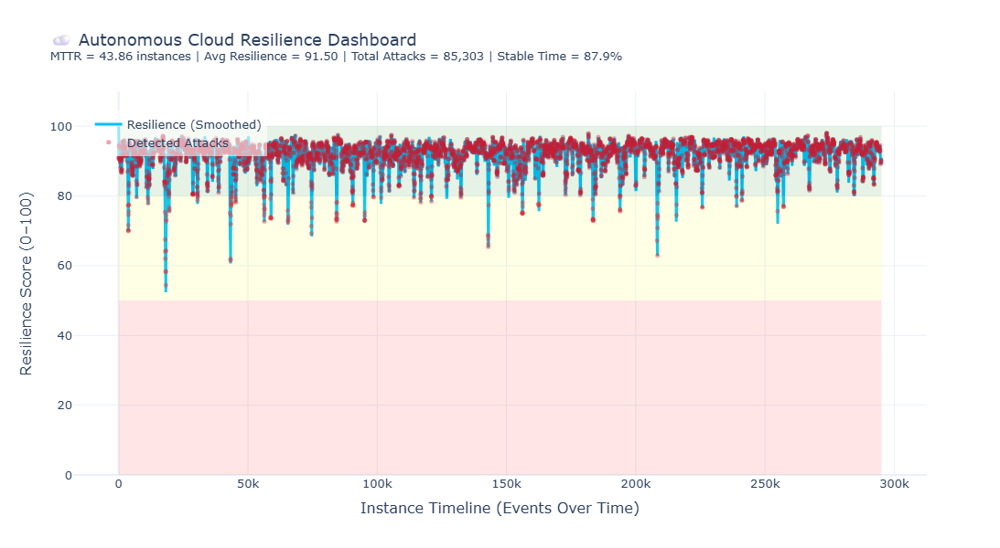

In [58]:
import numpy as np
import pandas as pd
import random
import plotly.graph_objects as go

# --- Label Mapping ---
label_map = {
    0: "Benign", 1: "Bot", 2: "Brute Force Web", 3: "Brute Force XSS",
    4: "FTP Brute Force", 5: "Infiltration", 6: "SQL Injection", 7: "SSH Brute Force"
}

# --- Initialize ---
resilience_score = 100
resilience_scores = []
healing_logs = []

# --- Auto-Healing Logic ---
def auto_heal(threat_type):
    global resilience_score
    damage = 0
    if threat_type in ["Infiltration", "SQL Injection"]:
        damage = 15
    elif "Brute Force" in threat_type:
        damage = 10
    elif threat_type == "Bot":
        damage = 8
    else:
        damage = 5

    # Apply impact & recovery
    resilience_score = max(resilience_score - damage, 0)
    resilience_score = min(resilience_score + random.randint(5, 12), 100)
    return resilience_score

# --- Simulation Loop ---
for i, pred in enumerate(y_pred_lgb):
    pred = int(pred) if isinstance(pred, (np.integer, int)) else pred
    threat_type = label_map.get(pred, "Unknown")

    if threat_type != "Benign":
        resilience_score = auto_heal(threat_type)
        healing_logs.append((i, threat_type, resilience_score))
    else:
        resilience_score = min(resilience_score + 2, 100)

    resilience_scores.append(resilience_score)

# --- Compute MTTR (Mean Time To Recovery) ---
recovery_times = []
recovery_in_progress = False
recovery_start = None

for i, score in enumerate(resilience_scores):
    if score < 70 and not recovery_in_progress:
        recovery_in_progress = True
        recovery_start = i
    elif recovery_in_progress and score >= 90:
        recovery_in_progress = False
        recovery_end = i
        recovery_times.append(recovery_end - recovery_start)

MTTR = np.mean(recovery_times) if recovery_times else 0

# --- Summary Metrics ---
avg_resilience = np.mean(resilience_scores)
num_attacks = sum(1 for p in y_pred_xgb if p != 0)
stable_ratio = sum(1 for r in resilience_scores if r >= 80) / len(resilience_scores) * 100

# --- Smooth the curve ---
ROLLING_WINDOW = 400
smooth_scores = pd.Series(resilience_scores).rolling(window=ROLLING_WINDOW, min_periods=1).mean()

# --- Prepare attack markers ---
attack_indices = [i for i, pred in enumerate(y_pred_xgb) if pred != 0]
attack_labels = [label_map[int(y_pred_xgb[i])] for i in attack_indices]

# --- Sample attacks to reduce visual clutter ---
# (Show only a subset so the line is visible)
if len(attack_indices) > 5000:
    sample_idx = np.random.choice(len(attack_indices), size=5000, replace=False)
    attack_indices = [attack_indices[i] for i in sample_idx]
    attack_labels = [attack_labels[i] for i in sample_idx]

# --- Create Plotly Figure ---
fig = go.Figure()

# Main resilience curve (smoothed)
fig.add_trace(go.Scatter(
    x=list(range(len(smooth_scores))),
    y=smooth_scores,
    mode='lines',
    line=dict(color='deepskyblue', width=3),
    name='Resilience (Smoothed)',
    hovertemplate="Index: %{x}<br>Resilience: %{y:.2f}"
))

# Attack markers (partially transparent)
fig.add_trace(go.Scatter(
    x=attack_indices,
    y=[smooth_scores[i] for i in attack_indices],
    mode='markers',
    marker=dict(color='crimson', size=5, opacity=0.4),
    name='Detected Attacks',
    text=attack_labels,
    hovertemplate="Attack: %{text}<br>Index: %{x}<br>Resilience: %{y:.2f}"
))

# --- Shaded Zones ---
fig.add_shape(type="rect", x0=0, x1=len(smooth_scores),
              y0=80, y1=100, fillcolor="green", opacity=0.1, line_width=0)
fig.add_shape(type="rect", x0=0, x1=len(smooth_scores),
              y0=50, y1=80, fillcolor="yellow", opacity=0.1, line_width=0)
fig.add_shape(type="rect", x0=0, x1=len(smooth_scores),
              y0=0, y1=50, fillcolor="red", opacity=0.1, line_width=0)

# --- Layout & Styling ---
fig.update_layout(
    title=(
        "☁️ Autonomous Cloud Resilience Dashboard<br>"
        f"<sup>MTTR = {MTTR:.2f} instances | "
        f"Avg Resilience = {avg_resilience:.2f} | "
        f"Total Attacks = {num_attacks:,} | "
        f"Stable Time = {stable_ratio:.1f}%</sup>"
    ),
    xaxis_title="Instance Timeline (Events Over Time)",
    yaxis_title="Resilience Score (0–100)",
    yaxis=dict(range=[0, 110]),
    template="plotly_white",
    legend=dict(x=0.02, y=0.95, bgcolor='rgba(255,255,255,0.6)'),
    height=600,
    font=dict(size=13),
    hovermode="x unified"
)

# --- Display ---
fig.show()


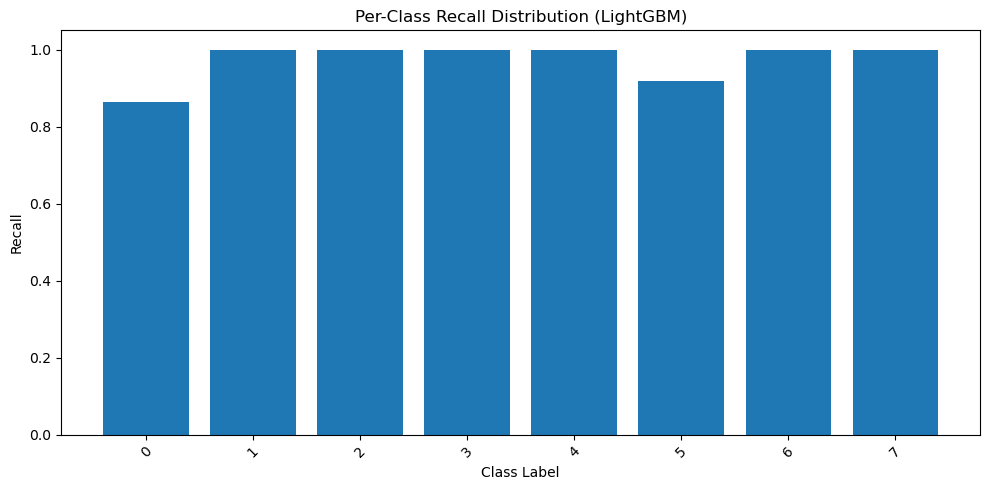

In [59]:
from sklearn.metrics import recall_score
import matplotlib.pyplot as plt
import numpy as np

# Compute per-class recall for LightGBM
per_class_recall_lgb = recall_score(
    y_test,
    y_pred_lgb,
    average=None
)

# Class labels (already encoded, use unique y_test values)
class_labels = np.unique(y_test)

plt.figure(figsize=(10, 5))
plt.bar(class_labels, per_class_recall_lgb)
plt.xlabel("Class Label")
plt.ylabel("Recall")
plt.title("Per-Class Recall Distribution (LightGBM)")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [60]:
# Get probability estimates for LightGBM
y_prob_lgb = lgb_model.predict_proba(X_test)


In [61]:
from sklearn.metrics import recall_score, f1_score, log_loss

def resilience_index(y_true, y_pred, y_prob, weights):
    w_rec, w_f1, w_ll = weights
    
    recall = recall_score(y_true, y_pred, average="macro")
    f1 = f1_score(y_true, y_pred, average="macro")
    ll = log_loss(y_true, y_prob)
    
    return (w_rec * recall) + (w_f1 * f1) + (w_ll * (1 - ll))


In [62]:
weight_configs = {
    "0.4-0.4-0.2 (Proposed)": (0.4, 0.4, 0.2),
    "0.5-0.3-0.2": (0.5, 0.3, 0.2),
    "0.3-0.5-0.2": (0.3, 0.5, 0.2),
    "Equal Weights": (0.33, 0.33, 0.34)
}

resilience_scores_lgb = {}

for name, weights in weight_configs.items():
    resilience_scores_lgb[name] = resilience_index(
        y_test,
        y_pred_lgb,
        y_prob_lgb,
        weights
    )

resilience_scores_lgb


{'0.4-0.4-0.2 (Proposed)': 0.8968604006892801,
 '0.5-0.3-0.2': 0.9060437652569352,
 '0.3-0.5-0.2': 0.8876770361216249,
 'Equal Weights': 0.8757385642434692}

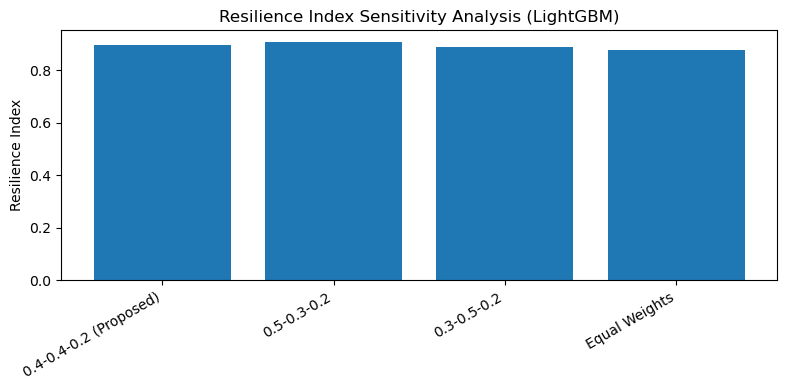

In [63]:
plt.figure(figsize=(8, 4))
plt.bar(resilience_scores_lgb.keys(), resilience_scores_lgb.values())
plt.ylabel("Resilience Index")
plt.title("Resilience Index Sensitivity Analysis (LightGBM)")
plt.xticks(rotation=30, ha="right")
plt.tight_layout()
plt.show()


In [64]:
import time

models = {
    "Random Forest": rf_model,
    "XGBoost": xgb_model,
    "LightGBM": lgb_model
}

inference_times = {}

for name, model in models.items():
    start_time = time.time()
    model.predict(X_test)
    total_time = time.time() - start_time
    inference_times[name] = total_time / len(X_test)

inference_times


{'Random Forest': 2.8125499000874745e-05,
 'XGBoost': 8.707163389593831e-06,
 'LightGBM': 3.061594903130298e-05}

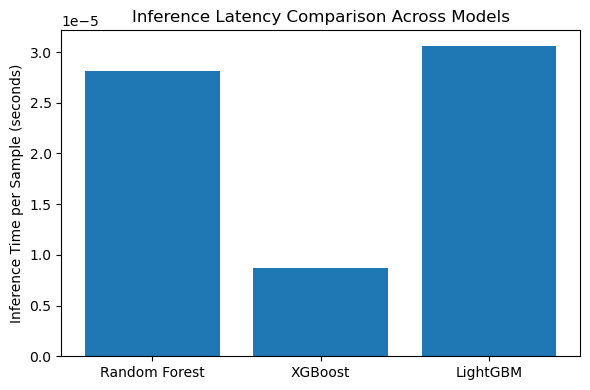

In [65]:
import matplotlib.pyplot as plt

plt.figure(figsize=(6, 4))
plt.bar(inference_times.keys(), inference_times.values())
plt.ylabel("Inference Time per Sample (seconds)")
plt.title("Inference Latency Comparison Across Models")
plt.tight_layout()
plt.show()
